---------------
# Example Usage
---------------

## Import your model (or use your own) 

In [3]:
import random

import torch
import yaml

from pytorch3dunet.unet3d.config import load_config
from pytorch3dunet.unet3d.trainer import create_trainer
from pytorch3dunet.unet3d.utils import get_logger

logger = get_logger('TrainingSetup')

config = yaml.safe_load(open('../fineTuneModel.yaml', 'r'))
# Get a device to train on
device_str = config.get('device', None)
if device_str is not None:
    logger.info(f"Device specified in config: '{device_str}'")
    if device_str.startswith('cuda') and not torch.cuda.is_available():
        logger.warning('CUDA not available, using CPU')
        device_str = 'cpu'
else:
    device_str = "cuda:0" if torch.cuda.is_available() else 'cpu'
    logger.info(f"Using '{device_str}' device")

device = torch.device(device_str)
config['device'] = device

logger.info(config)

manual_seed = config.get('manual_seed', None)
# create trainer
trainer = create_trainer(config)


2022-12-07 11:37:18,019 [MainThread] INFO TrainingSetup - Using 'cuda:0' device
2022-12-07 11:37:18,026 [MainThread] INFO TrainingSetup - {'model': {'name': 'UNet3D', 'in_channels': 1, 'out_channels': 1, 'layer_order': 'gcr', 'f_maps': 32, 'num_groups': 8, 'final_sigmoid': True}, 'loss': {'name': 'BCEDiceLoss', 'ignore_index': None, 'skip_last_target': True}, 'optimizer': {'learning_rate': 0.0002, 'weight_decay': 1e-05}, 'eval_metric': {'name': 'BoundaryAdaptedRandError', 'threshold': 0.4, 'use_last_target': True, 'use_first_input': True}, 'lr_scheduler': {'name': 'ReduceLROnPlateau', 'mode': 'min', 'factor': 0.5, 'patience': 30}, 'trainer': {'eval_score_higher_is_better': False, 'checkpoint_dir': '/media/pablo/d7c61090-024c-469a-930c-f5ada47fb049/PabloVicenteMunuera/transferLearning_Pytorch3DUnet/models', 'resume': None, 'pre_trained': '/media/pablo/d7c61090-024c-469a-930c-f5ada47fb049/PabloVicenteMunuera/transferLearning_Pytorch3DUnet/initialModels/initialModel.pytorch', 'validate_af

2022-12-07 11:37:20,680 [MainThread] INFO UNet3DTrainer - eval_score_higher_is_better: False
2022-12-07 11:37:20,710 [MainThread] INFO UNet3DTrainer - Logging pre-trained model from '/media/pablo/d7c61090-024c-469a-930c-f5ada47fb049/PabloVicenteMunuera/transferLearning_Pytorch3DUnet/initialModels/initialModel.pytorch'...


In [11]:
model = trainer.model
print(model)

UNet3D(
  (encoders): ModuleList(
    (0): Encoder(
      (basic_module): DoubleConv(
        (SingleConv1): SingleConv(
          (groupnorm): GroupNorm(1, 1, eps=1e-05, affine=True)
          (conv): Conv3d(1, 16, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1), bias=False)
          (ReLU): ReLU(inplace=True)
        )
        (SingleConv2): SingleConv(
          (groupnorm): GroupNorm(8, 16, eps=1e-05, affine=True)
          (conv): Conv3d(16, 32, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1), bias=False)
          (ReLU): ReLU(inplace=True)
        )
      )
    )
    (1): Encoder(
      (pooling): MaxPool3d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (basic_module): DoubleConv(
        (SingleConv1): SingleConv(
          (groupnorm): GroupNorm(8, 32, eps=1e-05, affine=True)
          (conv): Conv3d(32, 32, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1), bias=False)
          (ReLU): ReLU(inplace=True)
        )
     

## Import MapExtrakt

In [7]:
from MapExtrackt import FeatureExtractor


## Load Model

In [12]:
fe = FeatureExtractor(model)

In [13]:
fe.name

'UNet3D'

## Load image into the FeatureExtractor

##### (Can accept multiple types of image)

### > PIL Image

In [5]:
from PIL import Image
img = Image.open("pug.jpg")
fe.set_image(img)

### > Numpy array

In [6]:
import numpy as np
import cv2
img = cv2.imread("pug.jpg")
fe.set_image(img)

In [18]:
import h5py
import numpy as np
rawImgh5 = h5py.File("/media/pablo/d7c61090-024c-469a-930c-f5ada47fb049/PabloVicenteMunuera/CellShape3DAnalysis/Datasets/PreTrainedModel/RobTetley/Disc1_decon_c1_t1.h5", 'r')
rawImg = np.array(rawImgh5.get('raw'))
fe.set_image(img)

RuntimeError: Expected weight to be a vector of size equal to the number of channels in input, but got weight of shape [1] and input of shape [1, 512, 99, 512]

### > File Name

In [15]:
fe.set_image()

RuntimeError: output with shape [1, 512, 512] doesn't match the broadcast shape [3, 512, 512]

## From here we can check some information on the model, total layers, layer types, total cells (channels over all layers), cells per layers (channels over specific layer)

In [14]:
print(fe)

<BASE MODEL: UNet3D>
---------------------------
----- Class  settings -----
---------------------------
Layers: None
Total Cells: Not Loaded
Image: Not Loaded
Device: cuda
---------------------------
-- Image output settings --
---------------------------
Output Size: (800, 600)
Out Type: pil
Border Size: 3.0%
Picture in picture: True
Colourize Style: 20
Write Text: full


In [9]:
fe.layers

350

In [10]:
fe.layer_names

['Conv2d',
 'BatchNorm2d',
 'ReLU',
 'MaxPool2d',
 'Conv2d',
 'BatchNorm2d',
 'ReLU',
 'Conv2d',
 'BatchNorm2d',
 'ReLU',
 'Conv2d',
 'BatchNorm2d',
 'Conv2d',
 'BatchNorm2d',
 'Sequential (Block)',
 'ReLU',
 'Bottleneck (Block)',
 'Conv2d',
 'BatchNorm2d',
 'ReLU',
 'Conv2d',
 'BatchNorm2d',
 'ReLU',
 'Conv2d',
 'BatchNorm2d',
 'ReLU',
 'Bottleneck (Block)',
 'Conv2d',
 'BatchNorm2d',
 'ReLU',
 'Conv2d',
 'BatchNorm2d',
 'ReLU',
 'Conv2d',
 'BatchNorm2d',
 'ReLU',
 'Bottleneck (Block)',
 'Sequential (Block)',
 'Conv2d',
 'BatchNorm2d',
 'ReLU',
 'Conv2d',
 'BatchNorm2d',
 'ReLU',
 'Conv2d',
 'BatchNorm2d',
 'Conv2d',
 'BatchNorm2d',
 'Sequential (Block)',
 'ReLU',
 'Bottleneck (Block)',
 'Conv2d',
 'BatchNorm2d',
 'ReLU',
 'Conv2d',
 'BatchNorm2d',
 'ReLU',
 'Conv2d',
 'BatchNorm2d',
 'ReLU',
 'Bottleneck (Block)',
 'Conv2d',
 'BatchNorm2d',
 'ReLU',
 'Conv2d',
 'BatchNorm2d',
 'ReLU',
 'Conv2d',
 'BatchNorm2d',
 'ReLU',
 'Bottleneck (Block)',
 'Conv2d',
 'BatchNorm2d',
 'ReLU',
 'Con

* If you wanted to extract just the Convolution layers add the parameter allowed_modules=["conv"] when you set_image.

* If you wanted to extract just the ReLU layers add the parameter allowed_modules=["relu"] when you set_image. 

* If you wanted to extract just the Normalization layers add the parameter allowed_modules=["norm"] when you set_image.

* If your model is constructed on BLOCKS you can use allowed_modules=["block_name"] to extract only the block outputs.

* You can use multiple terms i.e allowed_modules=["conv","pool"]

* If you want to specify the recursion depth you can with allowed_depth = n   - this will only go n deep into nested sequential blocks.

*i.e examine the below for example.*

- An allowed_depth of 0 would only include the outer most laters (conv1,bn1,relu,maxpool,later1 etc) 
- An allowed_depth of 1 would include the above + the "bottleneck"

and so on

`ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
    )`


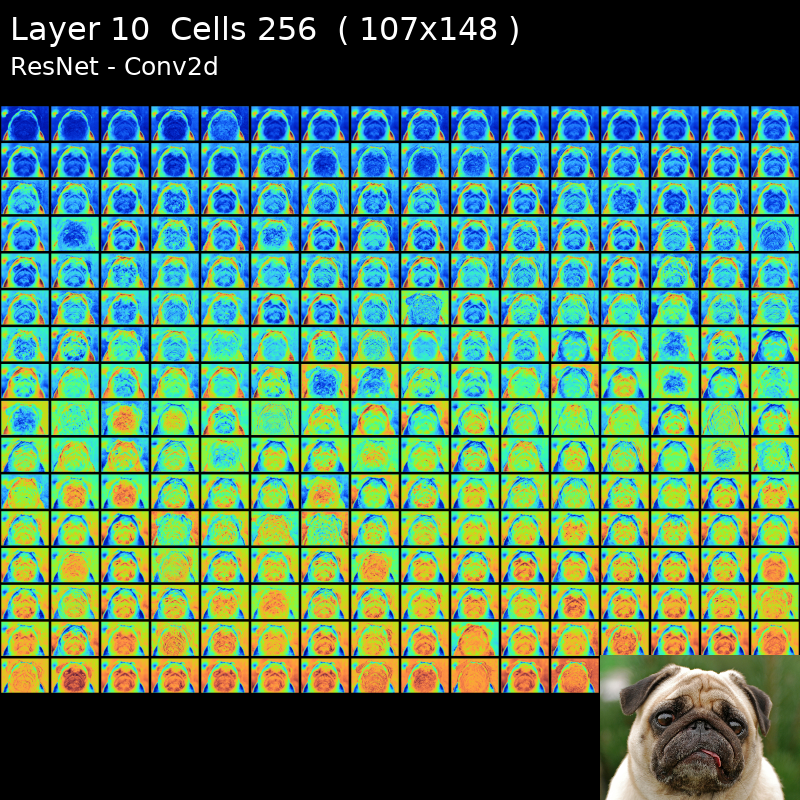

In [11]:
fe.display_from_map(layer_no=10,outsize=(800,800))

In [12]:
fe.get_total_cells()

194082

In [13]:
fe.get_cells(layer_no=3)

64

-----------------
# Viewing Layers
-----------------

### You can view layers as a whole, displaying each inner cell (channel) together.


## To get the second layer (i.e Conv2D)

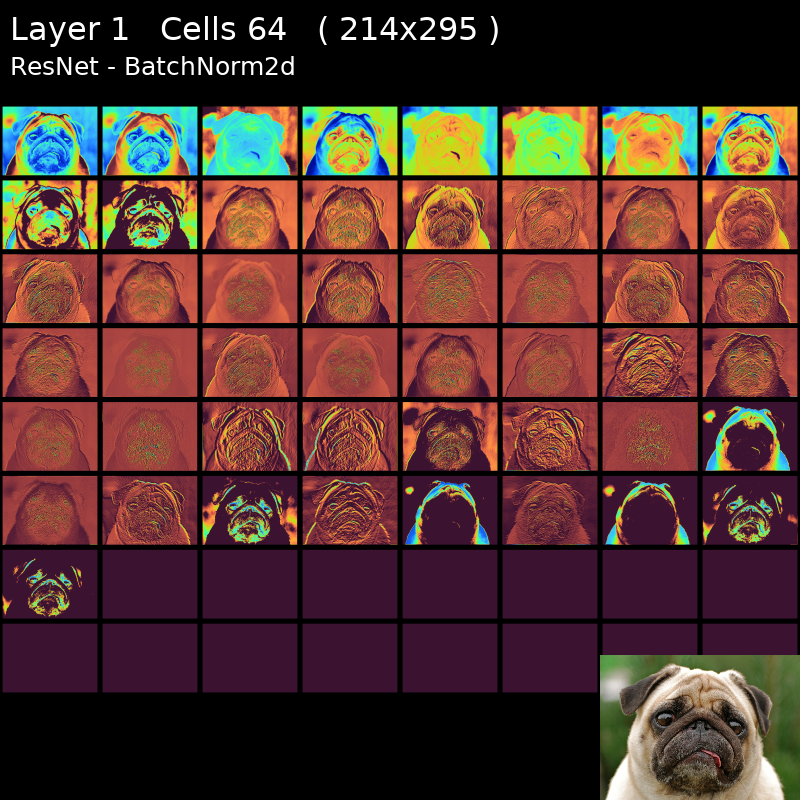

In [16]:
img = fe.display_from_map(layer_no=1,outsize=(800,800))
img

## Save the image

In [14]:
img.save("example.jpg")

## Or to get the 9th layer 

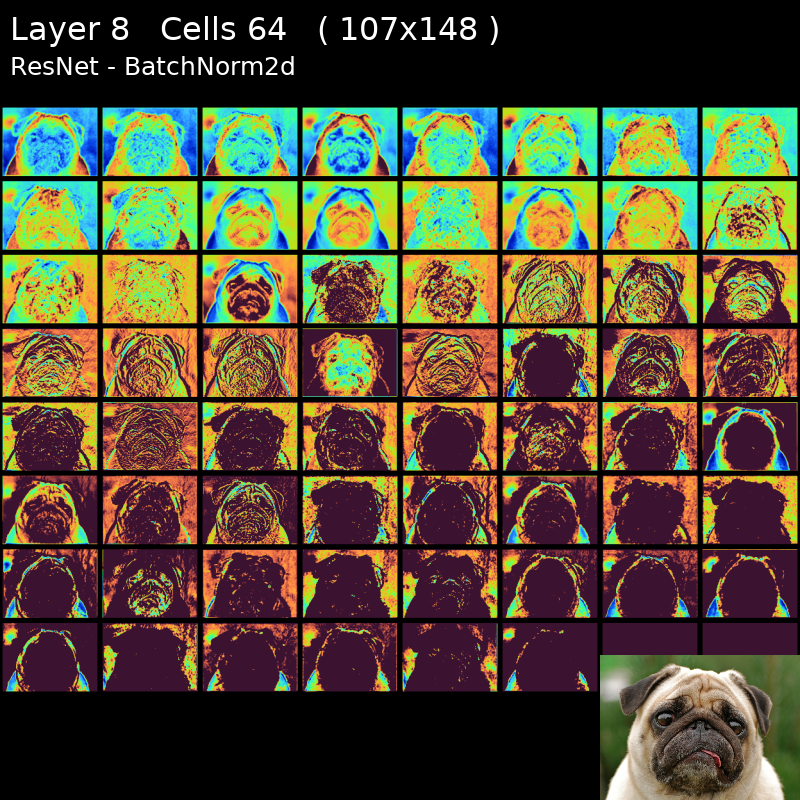

In [17]:
fe.display_from_map(layer_no=8)

### outputs by default are set to 1080 resolution. This can be changed. NOTE setting outsize to 'False' results in the layer displaying each cell as their actual size.

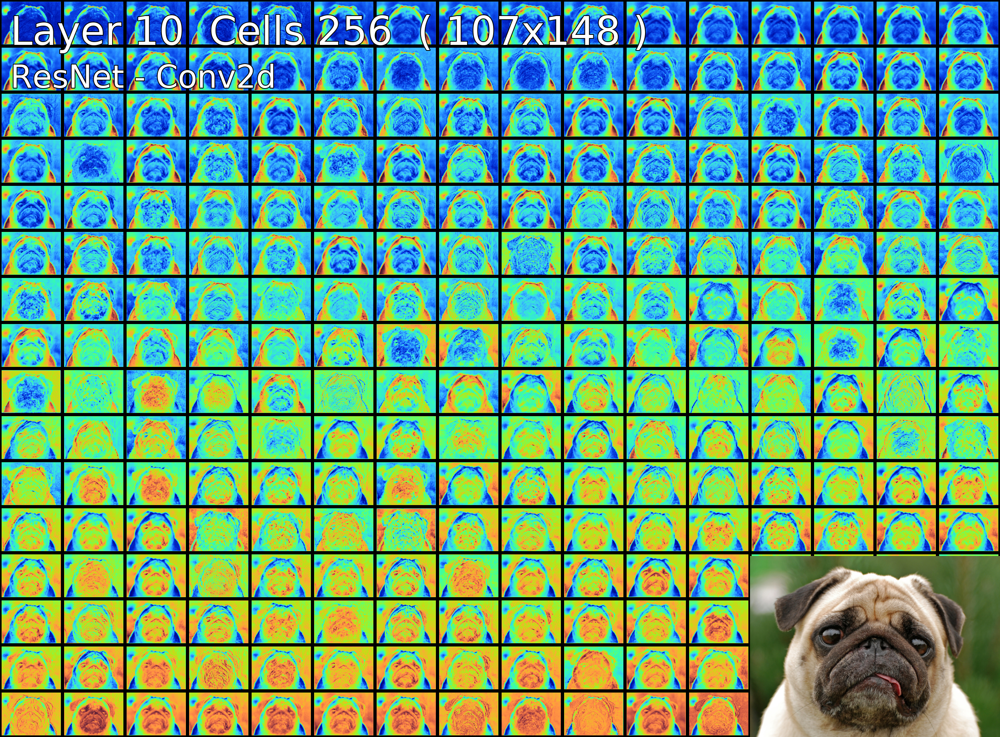

In [18]:
fe.display_from_map(layer_no=10, outsize=False)



### Or you can set a custom output size - the cells attempt to fit the best they can to the 'outsize' ratio

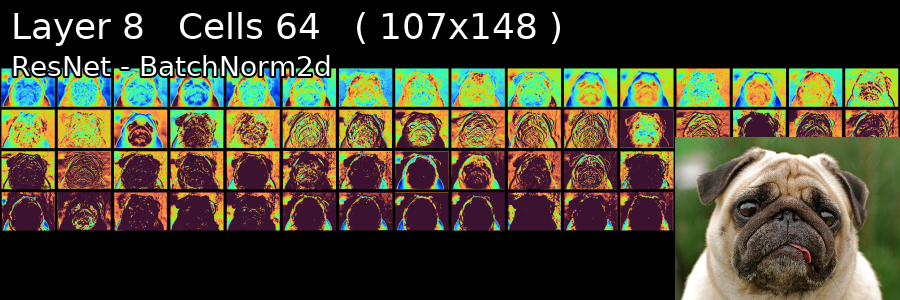

In [19]:
fe.display_from_map(layer_no=8, outsize=(900,300))

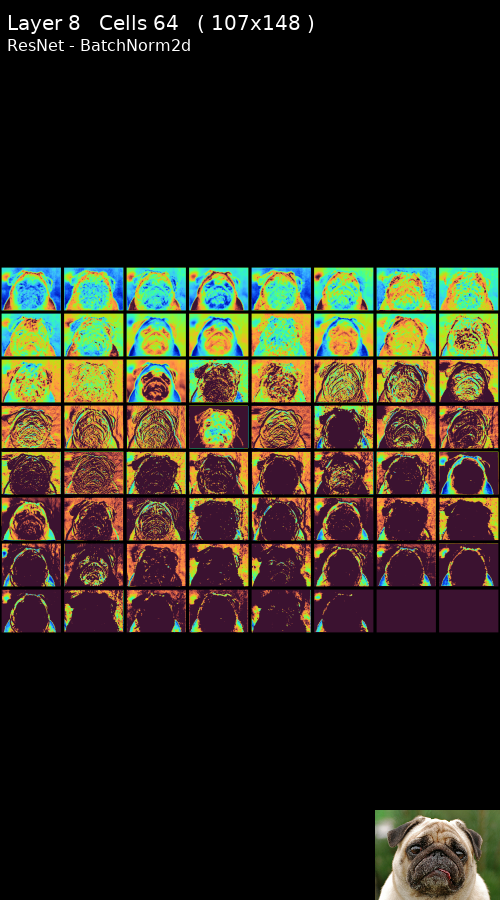

In [20]:
fe.display_from_map(layer_no=8, outsize=(500,900))

### You can turn off the picture in picture 

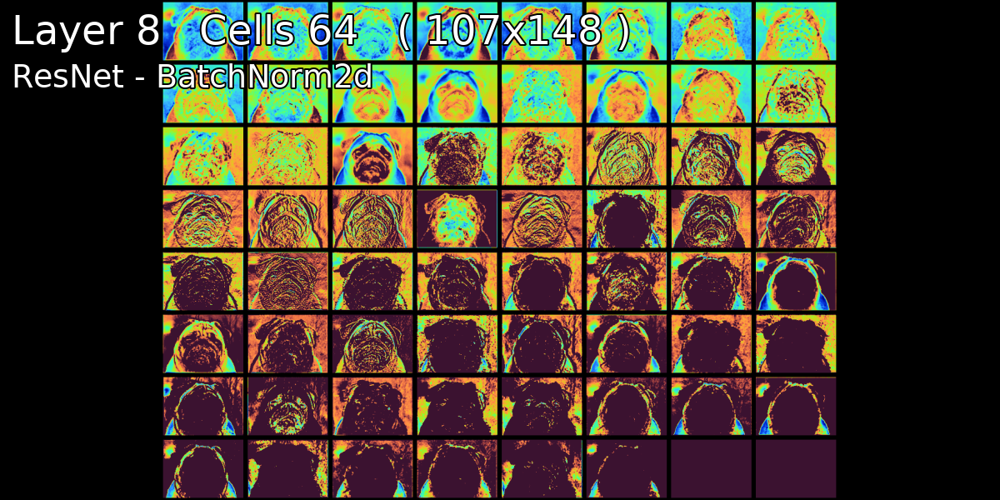

In [21]:
fe.display_from_map(layer_no=8, outsize=(1200,600),picture_in_picture=False)

### Or turn off the text 

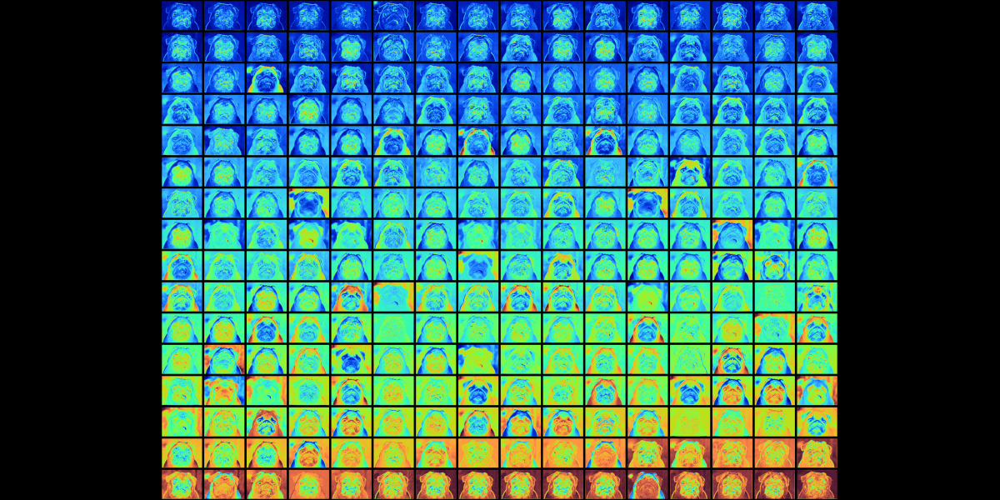

In [22]:
fe.display_from_map(layer_no=12, outsize=(1200,600),write_text="none")

## Colourization of the cells colour can be changed.

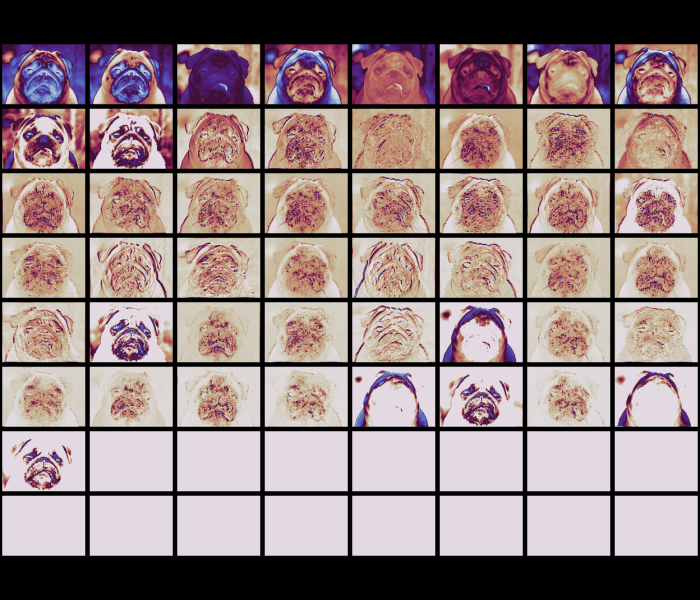

In [23]:
fe.display_from_map(layer_no=3, outsize=(700,600), colourize=18)

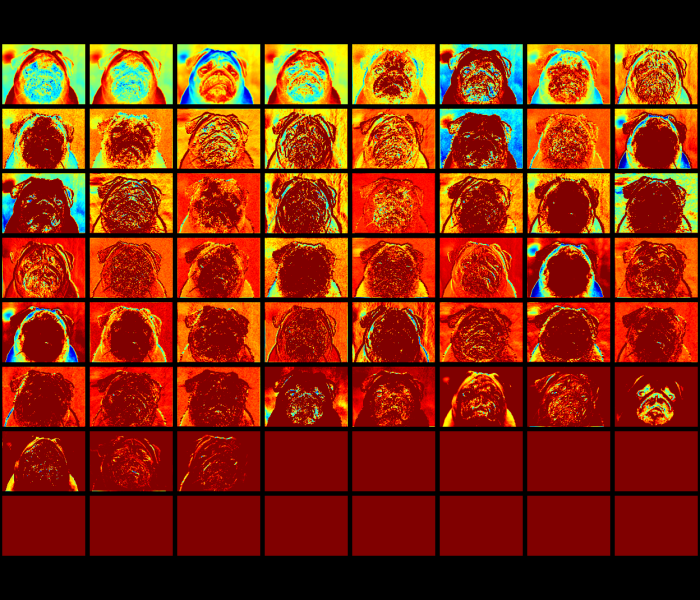

In [24]:
fe.display_from_map(layer_no=6, colourize=2)

## Colourize 0 is grey scale as nature intended it

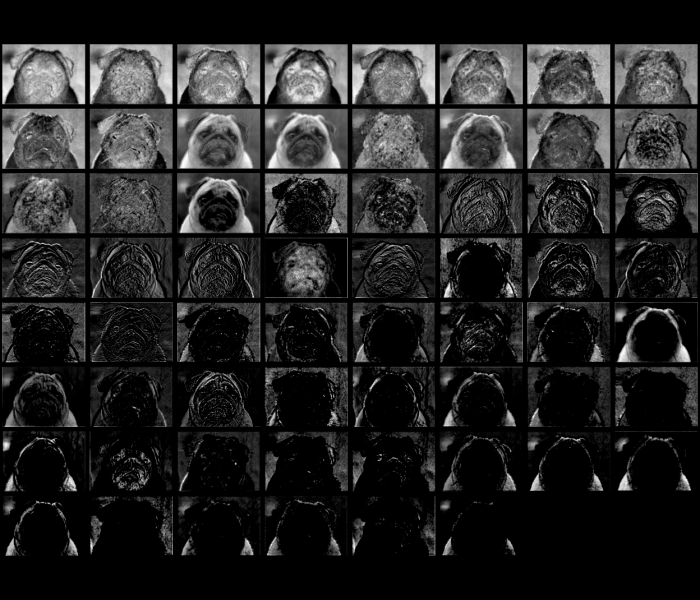

In [26]:
fe.display_from_map(layer_no=8, colourize=0)

## The border size around cells can be changed. The value is a % of the cells total width.

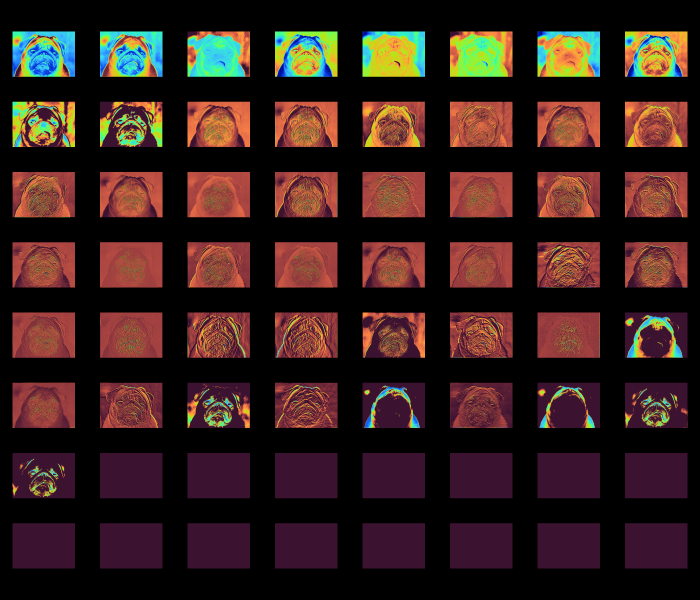

In [27]:
fe.display_from_map(layer_no=1, border=0.2, colourize=20)

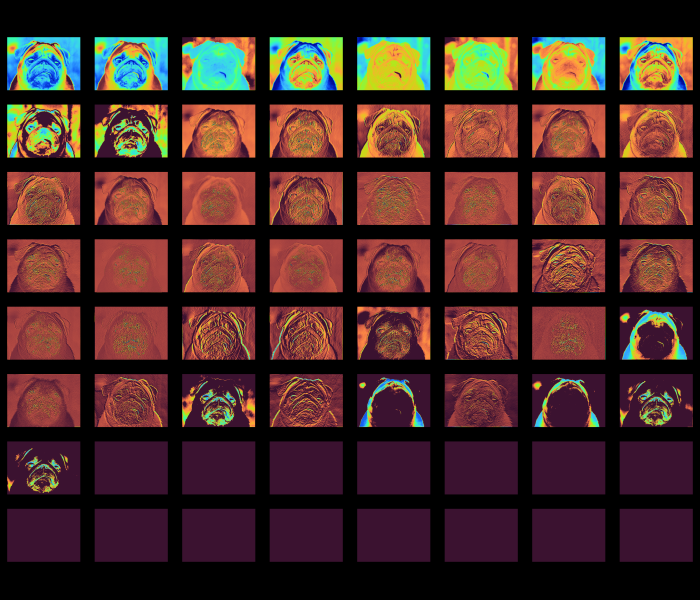

In [28]:
fe.display_from_map(layer_no=1, border=0.1)

-----------------
# Viewing Individual Cells
-----------------

### You can view individual cells in a similar fasion. You only need to pass the cells number you want from each layer.



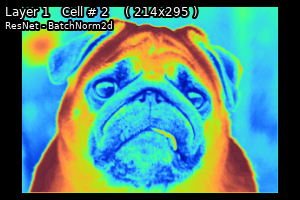

In [29]:
fe.display_from_map(layer_no=1,cell_no=1,border=0.03,write_text="full",outsize=(300,200))


## Setting outsize to "False" displays cell at actual size

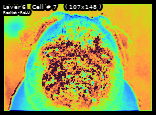

In [30]:
fe.display_from_map(layer_no=6,cell_no=6,outsize=False)

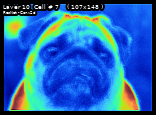

In [31]:
fe.display_from_map(layer_no=10,cell_no=6,outsize=False)

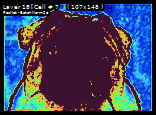

In [32]:
fe.display_from_map(layer_no=18,cell_no=6,outsize=False)

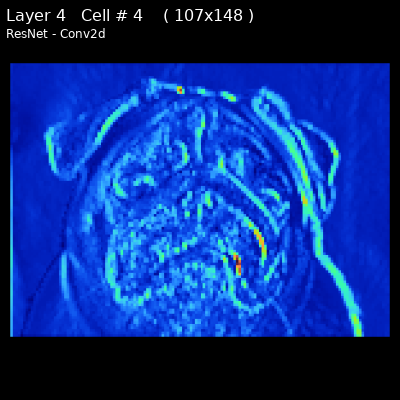

In [33]:
fe.display_from_map(layer_no=4,cell_no=3,outsize=(400,400))

## Stacking cells is possible like so. 

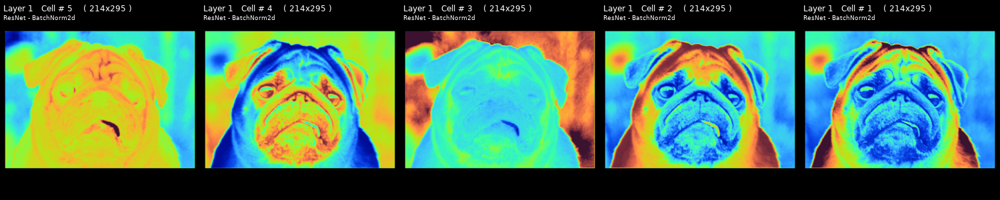

In [34]:
img_stack = np.array([])
for i,x in enumerate(range(5)):
    img = fe.display_from_map(layer_no=1,cell_no=x,outsize=(300,300), picture_in_picture=False, write_text="full")
    if i == 0:
        img_stack = img
    else:
        img_stack = np.hstack((img,img_stack))
        
img = Image.fromarray(img_stack)
img.save("Example_stack.jpg")
img

## Or saving a range of cells to file

In [37]:
idx_from = 0
idx_to = 20

_ = [fe.display_from_map(layer_no=9,cell_no=x).save(f"./pug_cells/file{x}.jpg") for x in range(idx_from,idx_to)]

-----------------------
# Changing settings (without generating output)
-----------------------
## Settings are saved each time an output is generated and stored for the next output
### This can be changed at any time by generating a new output or using the following. Any or all of the parameters can be used.

In [38]:
fe.set_output(out_type="np")
fe.display_from_map(layer_no=1)

array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)

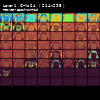

In [39]:
fe.set_output(outsize=(100,100),out_type="pil")
fe.display_from_map(layer_no=1)

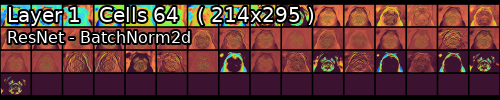

In [40]:
fe.set_output(outsize=(500,100))
fe.display_from_map(layer_no=1)

-----------------
# Slicing
-----------------

## You can slice the class to return the layers you require.

### Output setting are stored from the previous output. If no previous outputs then defaults are used.
### To overwrite you can use the above 'set_output' function



In [59]:
fe.set_image("doggo.jpg")

In [60]:
fe.set_output(outsize=(800,600))

### Get layer 4

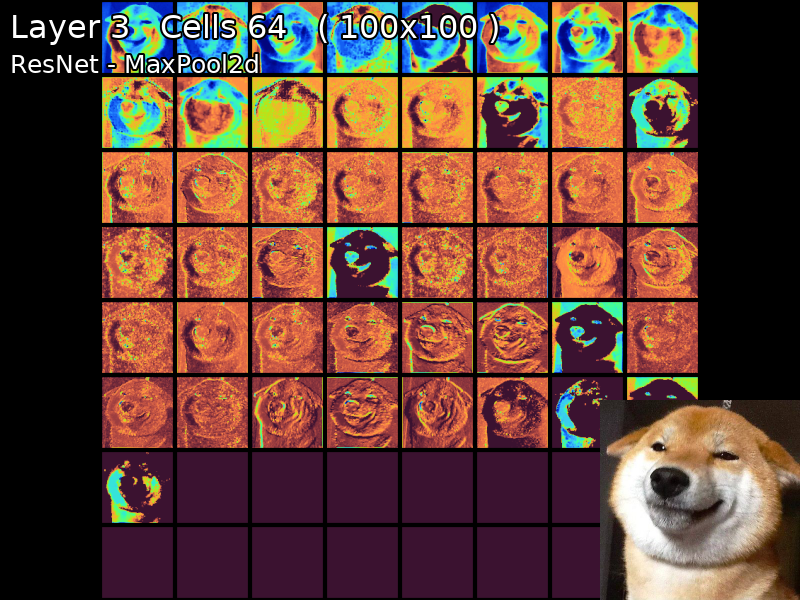

In [61]:
fe[3]

### Layer 6

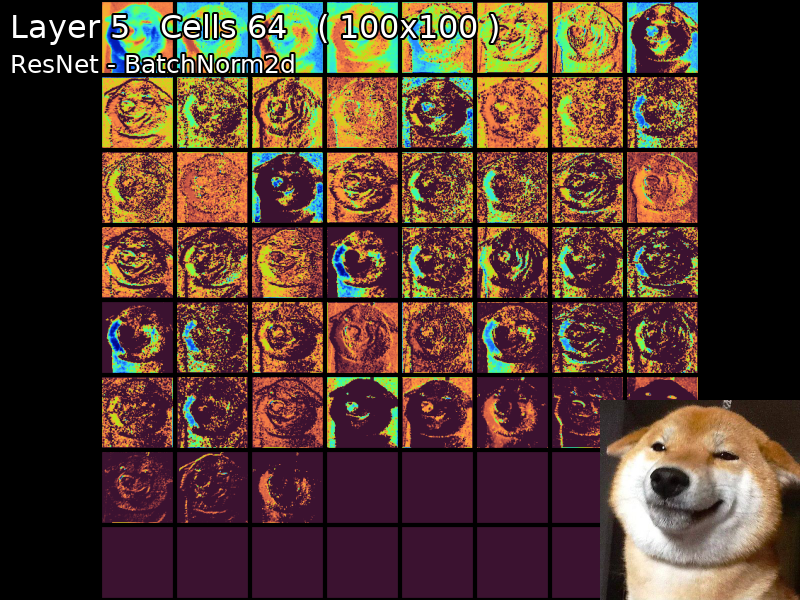

In [62]:
fe[5]

## But hey, who wants to see thoes lower cells? Not me.

### Layer 6 cells 1 to 9

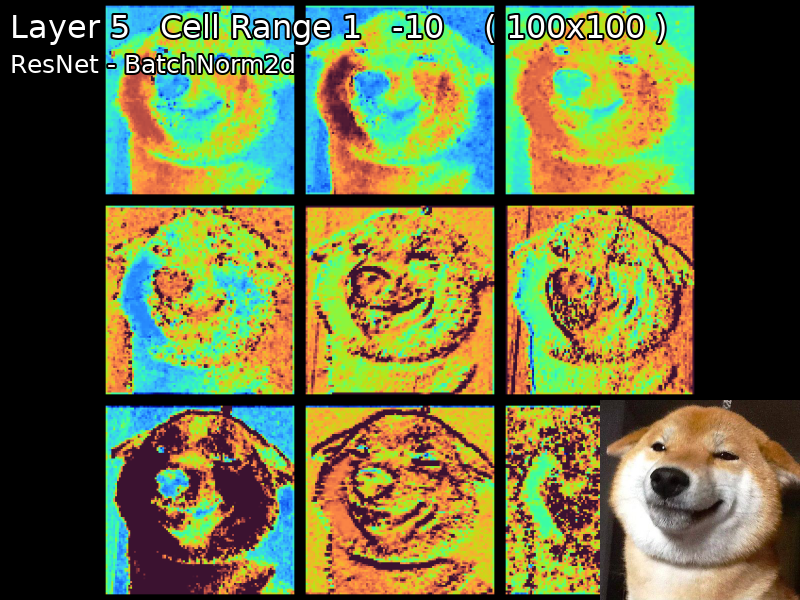

In [63]:
fe[5,1:10]

### Change the output and gather layer 6 cells 0 to 39

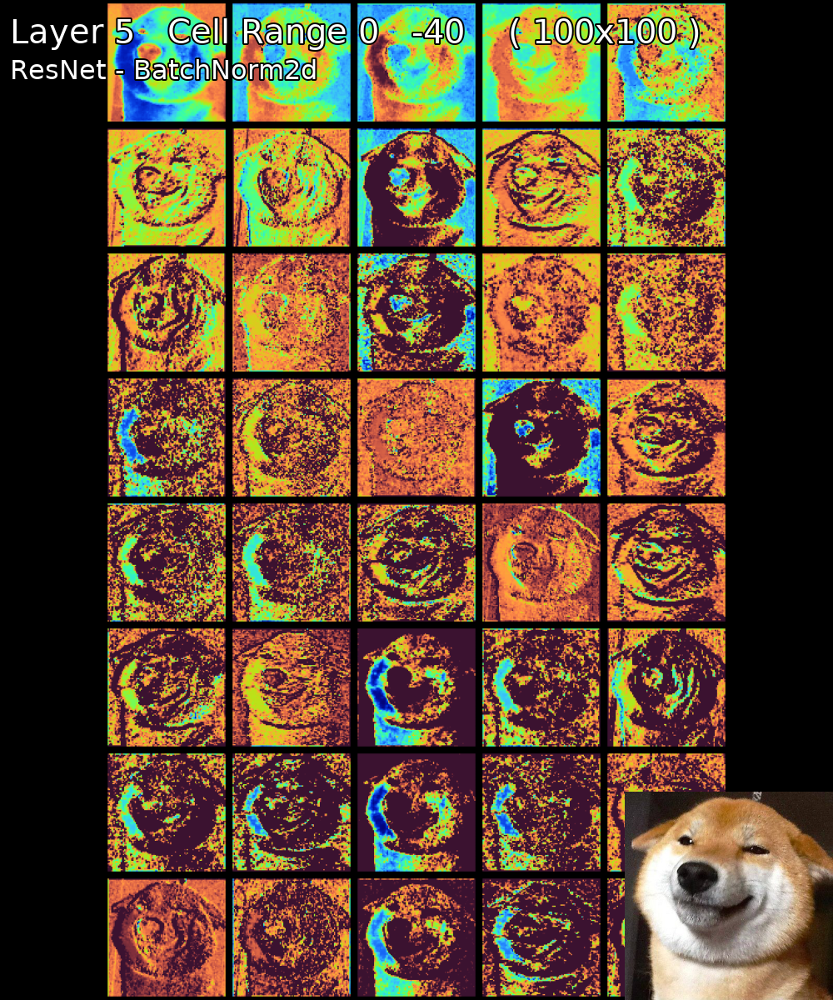

In [64]:
fe.set_output(outsize=(1000,1200))
fe[5,0:40]

# Single cells are not an issue 

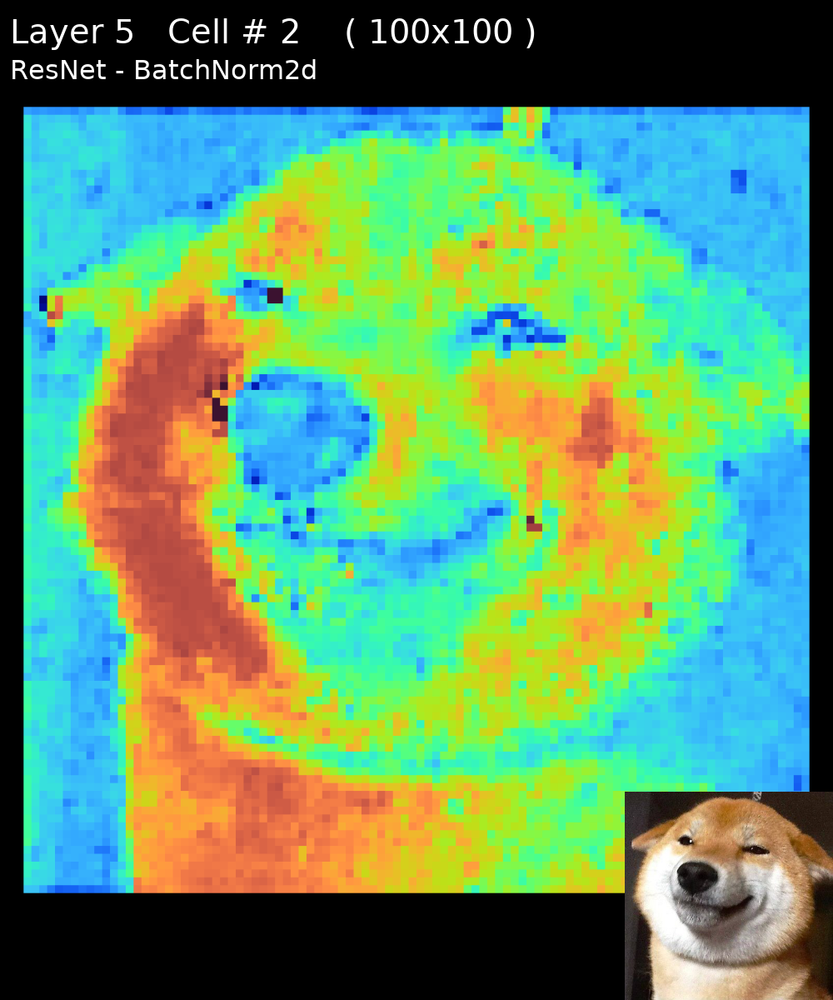

In [65]:
fe[5,1]

# Or backwards

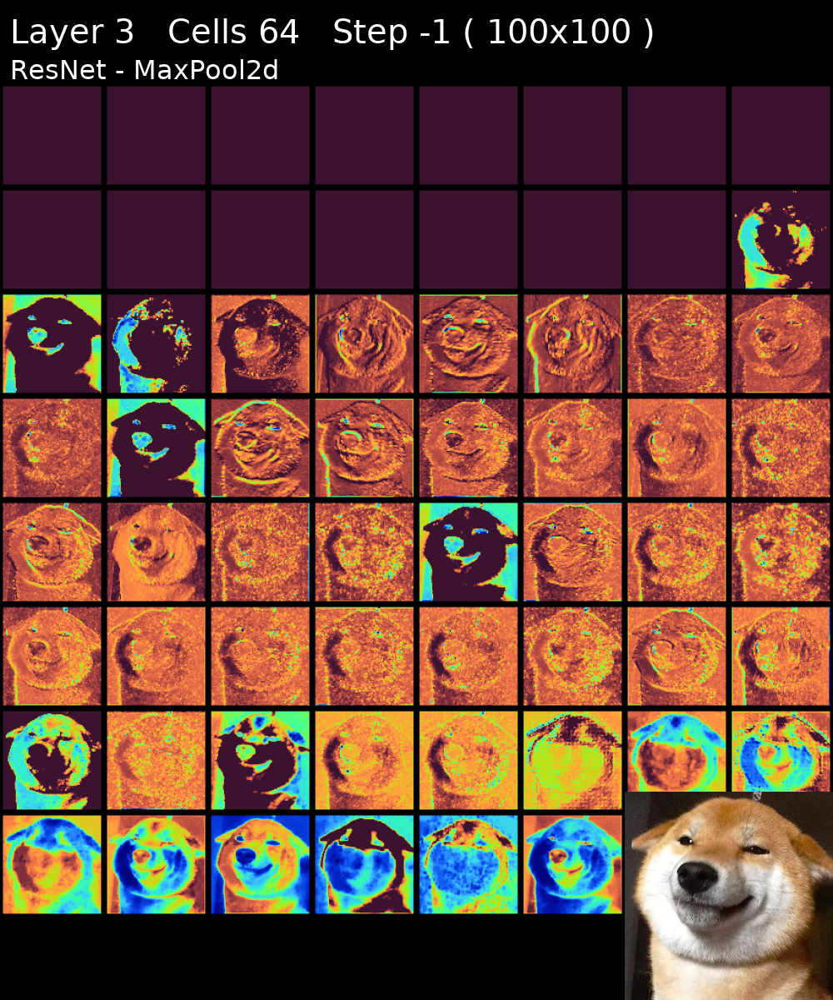

In [66]:
fe[3,::-1]

# Using step size

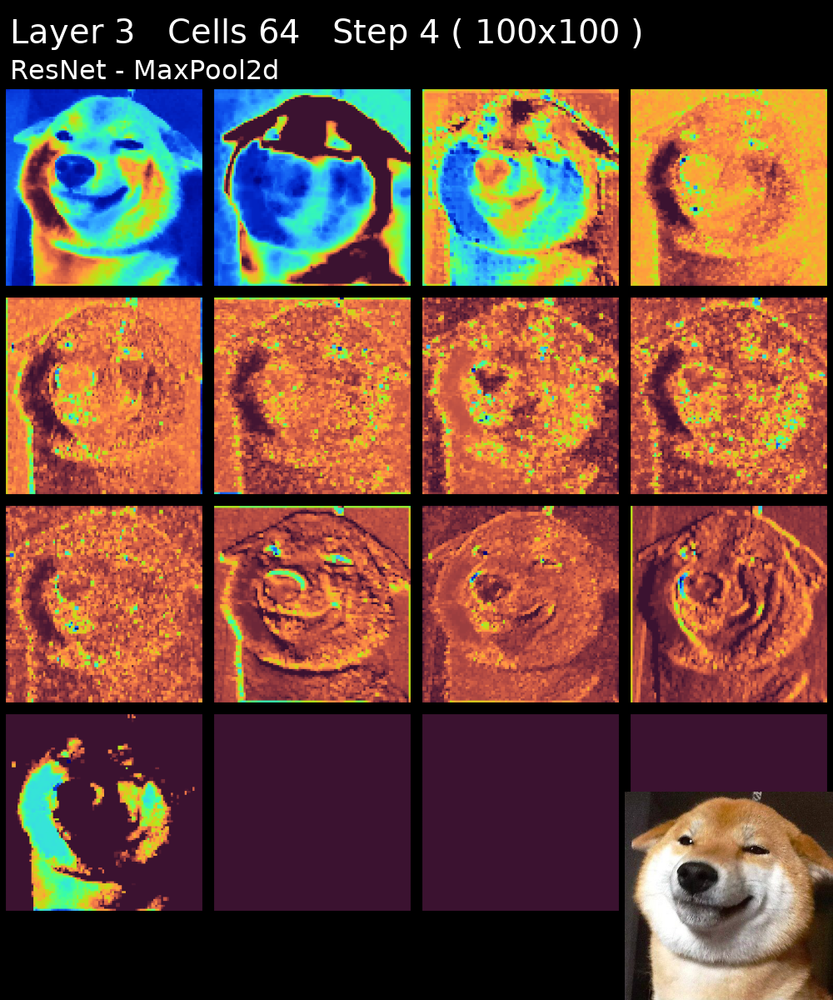

In [67]:

fe[3,::4]

## The lower layers look more interesting close up, information is lost . Lets filter some of the lower ranges

> Resizing looses information...

In [71]:
fe.set_output(outsize=(1000,1200))
layer = 3

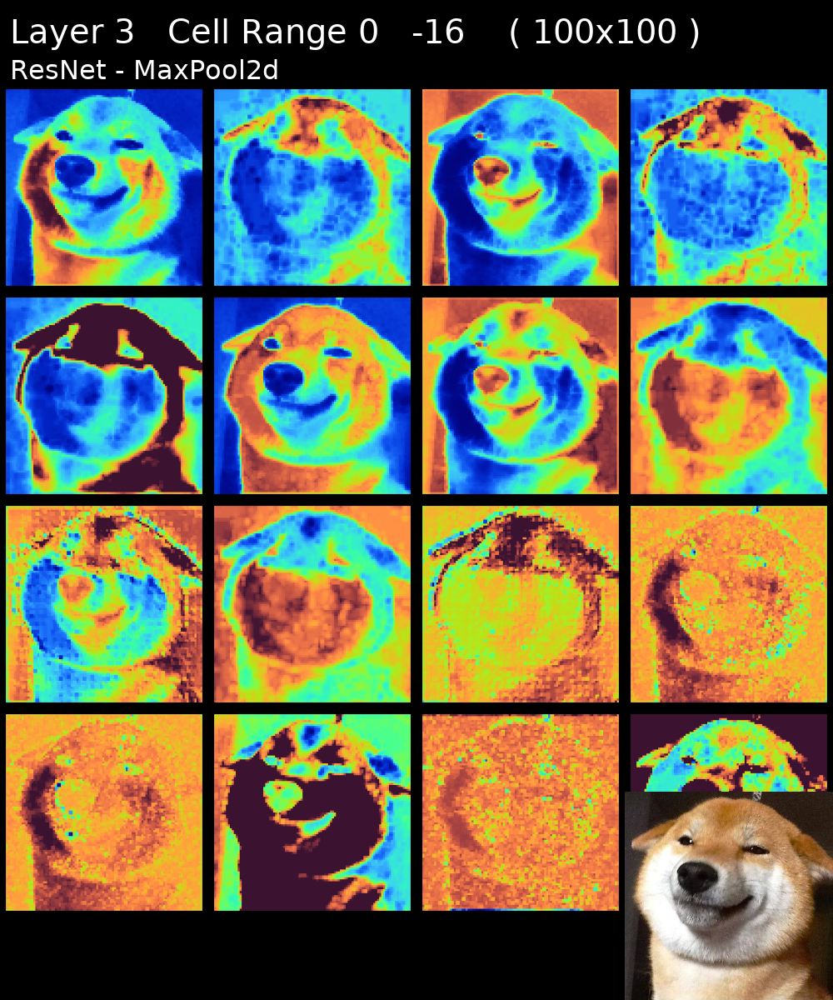

In [79]:
fe[layer, 0:int(fe.get_cells(layer)*.25)]

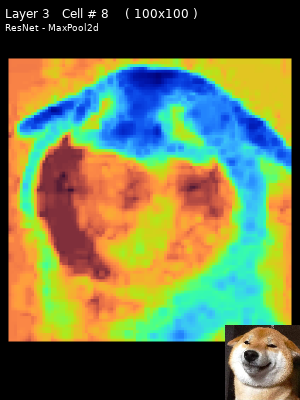

In [84]:
fe.set_output(outsize=(300,400))
fe[layer,7]

# But what if we didn't just all the layers from the model? What if we JUST wanted the RELU's instead.


In [85]:
fe.set_image("cat.jpg",allowed_modules=["relu"])


In [86]:
fe.layer_names

['ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU',
 'ReLU']

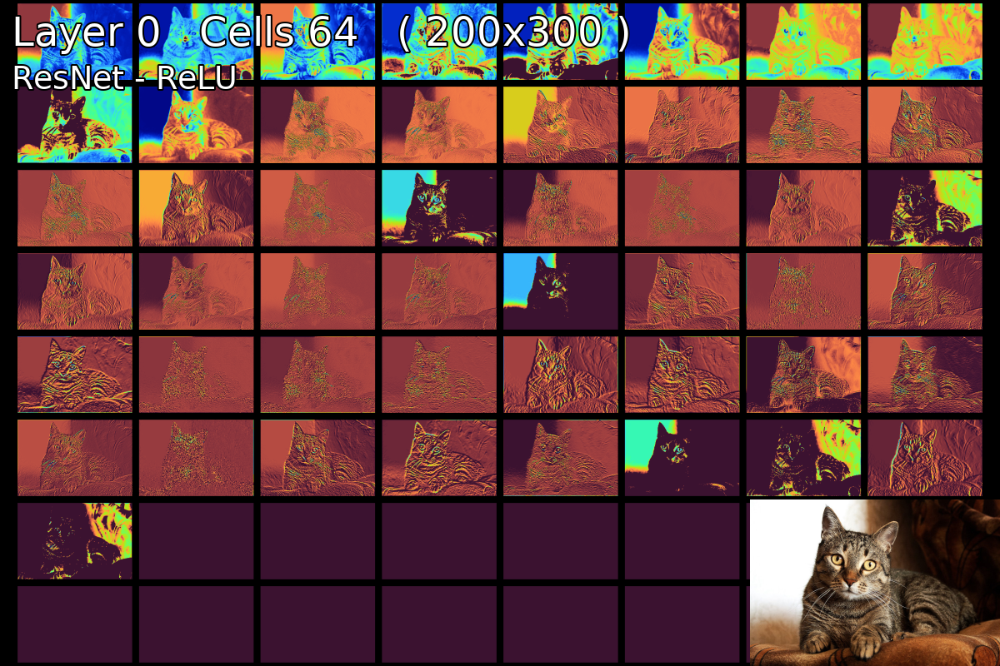

In [87]:
fe.set_output(outsize=(1200,800), picture_in_picture=True)
fe[0]

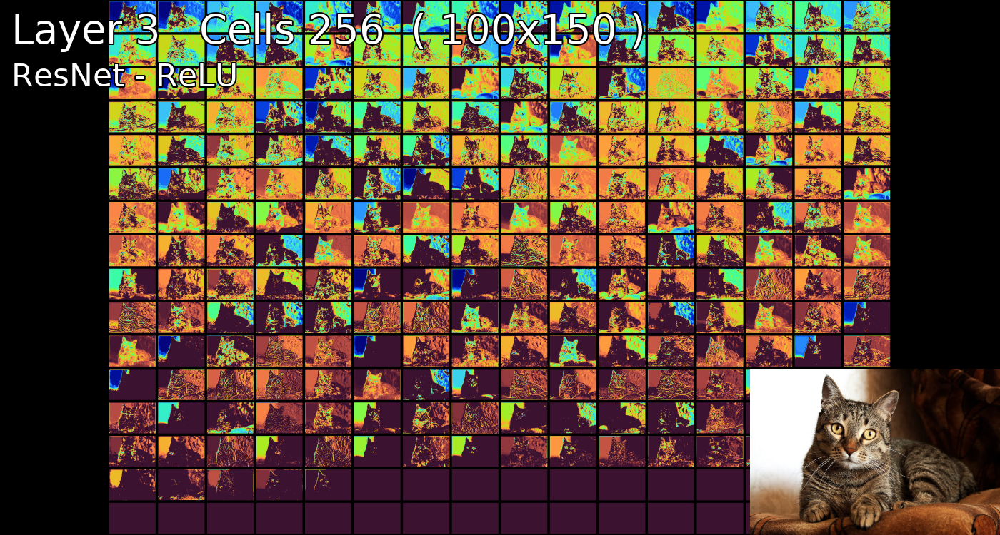

In [88]:
fe.set_output(outsize=(1400,750),)
fe[3]

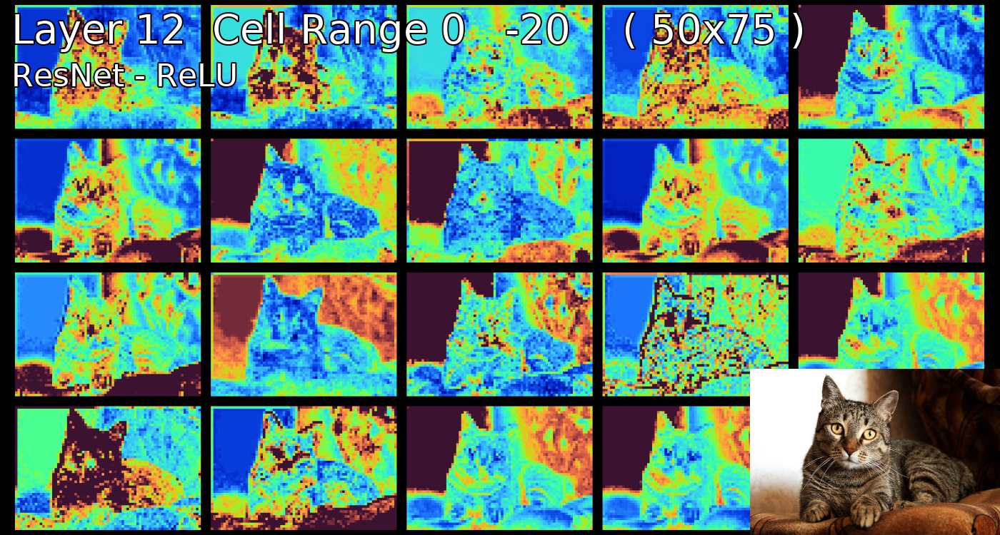

In [89]:
fe[12,0:20]

# Or we might just want the "bottleneck" layers

In [90]:
fe.set_image("cat.jpg",allowed_modules=["bottleneck"])


In [91]:
fe.layer_names

['Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)',
 'Bottleneck (Block)']

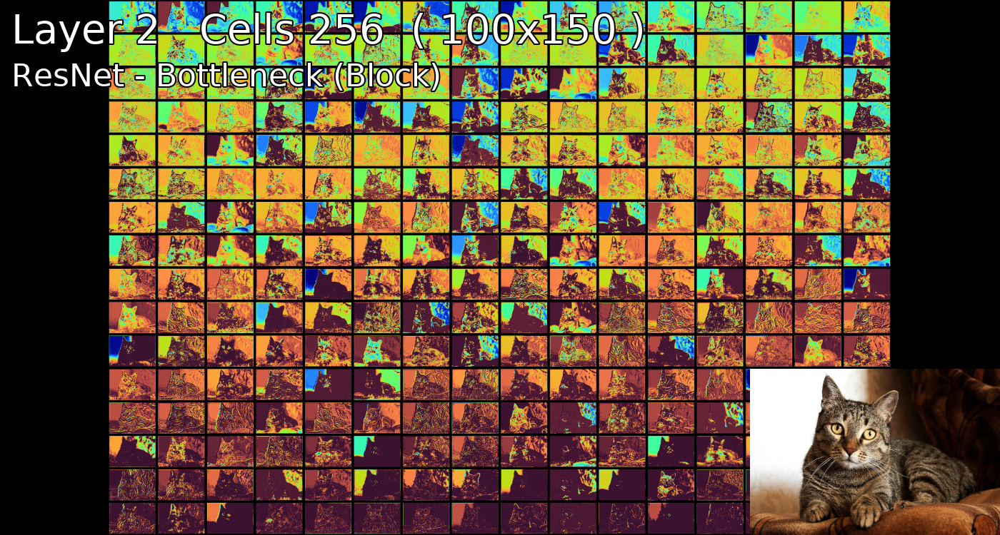

In [94]:
fe[2]

# Or the Just the top most layers (ignoring any nested sequential blocks etc)


In [95]:
fe.set_image("dog.jpg",allowed_depth=0)

In [98]:
fe.layer_names

['Conv2d',
 'BatchNorm2d',
 'ReLU',
 'MaxPool2d',
 'Sequential (Block)',
 'Sequential (Block)',
 'Sequential (Block)',
 'Sequential (Block)']

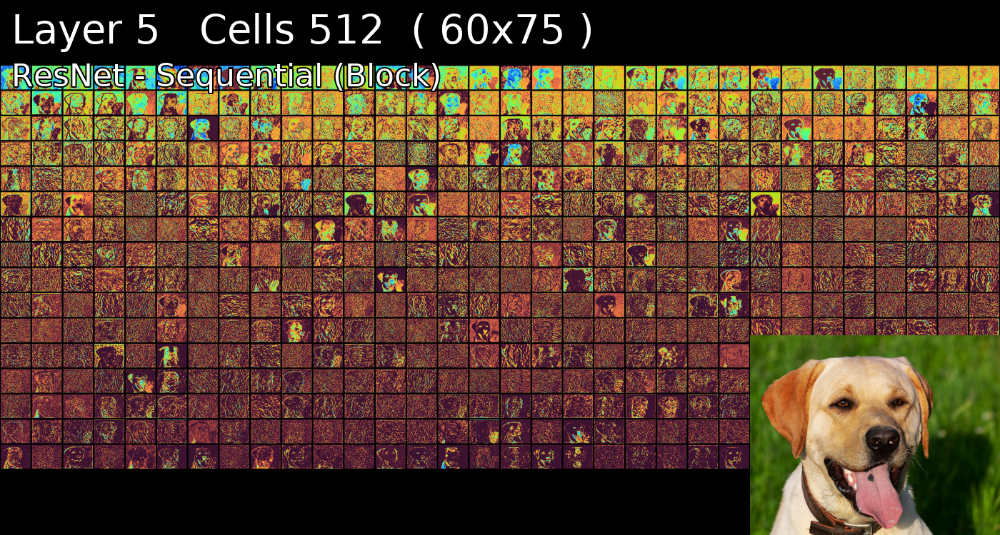

In [99]:
fe[5]

# Or the Just the conv and pool layers

In [100]:
fe.set_image("dog.jpg",allowed_modules=["conv","pool"])

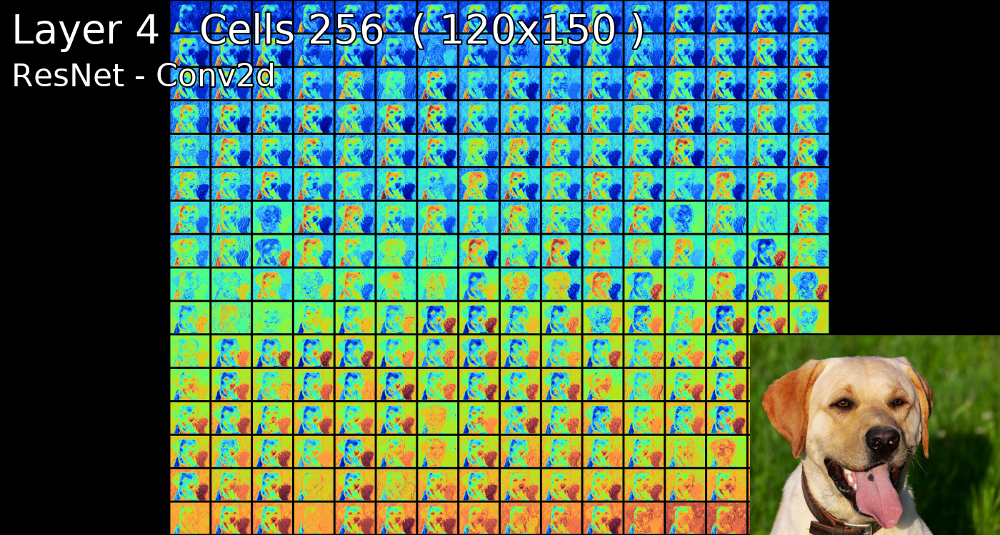

In [102]:
fe[4]

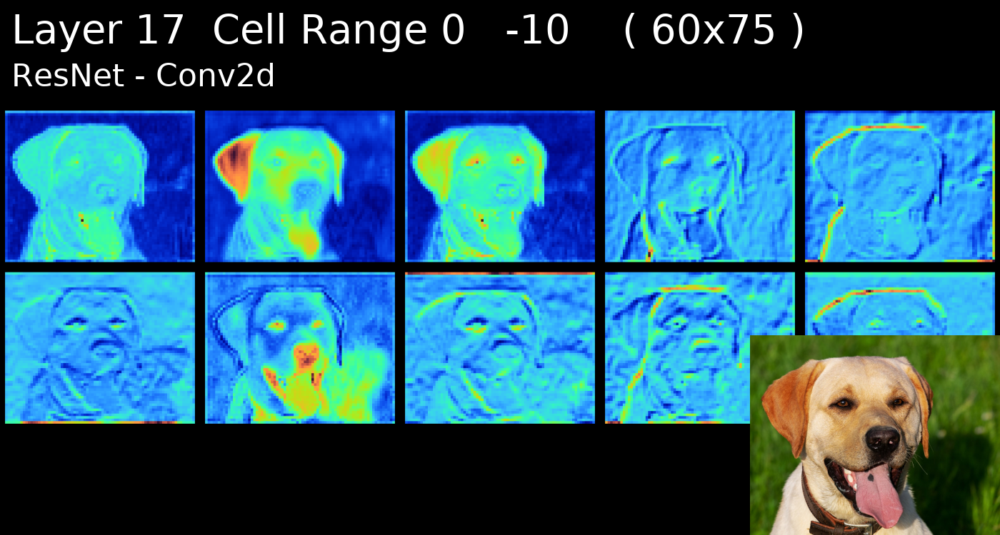

In [109]:
fe[17,0:10]

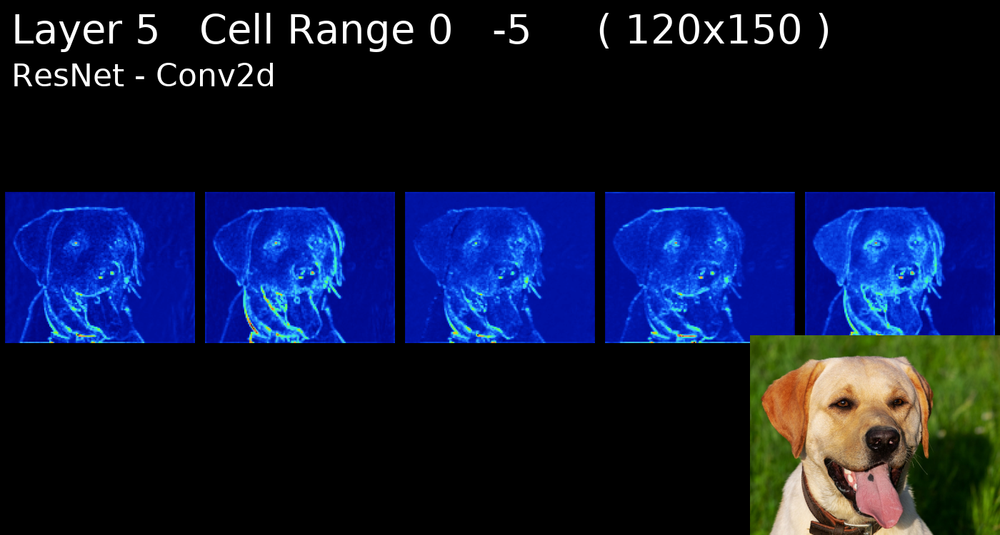

In [110]:
fe[5,0:5]

# Video Creation

## Videos of the layers can be generated 

### As normal, settings are caried over from the previous output or can be defined in the function call.

### "time_for_layer" is the time in seconds to display the layers. 
### "transition_perc_layer" is the % of each layers display time to fade to next frame. For no fade set to 0

#### TODO 

- [ ] Finalize option to display cells individually.

In [61]:
fe.write_video(out_size=(1920,1080), file_name="output.avi", time_for_layer=60, transition_perc_layer=0.2)

Drawing Layers 22   /22   Total Time Taken 0:00:57    Time Left 0:00:00    [=============================-] 95.65 %  
Video saved as output.avi


<a href="https://www.youtube.com/watch?v=LZTGIYxczFc&feature=youtu.be" target="_blank">
    <img src="https://raw.githubusercontent.com/lewis-morris/mapextrackt/master/examples/youtube.png" alt="MapExtrakt" border="10" />
</a>
